## 环境信息

In [1]:
import tensorflow as tf
print("Num GPUs Available: ", len(tf.config.list_physical_devices('GPU')))

import torch
if torch.cuda.is_available():
    device = torch.device("cuda")
    print("使用的设备：", torch.cuda.get_device_name(0))  # 获取第一个 CUDA 设备的名称
else:
    device = torch.device("cpu")
    print("CUDA 不可用，将使用 CPU。")

print("PyTorch 版本：", torch.__version__)
print("使用的设备类型：", device)
print("CUDA 版本：", torch.version.cuda)

2024-07-15 08:38:48.548349: I tensorflow/core/util/port.cc:110] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2024-07-15 08:38:48.682138: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 AVX_VNNI FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2024-07-15 08:38:49.495551: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT


Num GPUs Available:  1


2024-07-15 08:38:51.164530: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:996] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2024-07-15 08:38:51.185495: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:996] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2024-07-15 08:38:51.185908: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:996] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysf

使用的设备： NVIDIA RTX 3500 Ada Generation Laptop GPU
PyTorch 版本： 1.11.0
使用的设备类型： cuda
CUDA 版本： 11.3


## 单场景推理

In [8]:
import os 
import sys
src_path = os.path.join(os.getcwd(), 'src')
if src_path not in sys.path:
    sys.path.append(src_path)

from data_modules.data_h5_womd import DataH5womd
import pl_modules.waymo_motion as waymo_motion_module

import torch
import pickle
import tensorflow as tf
import numpy as np

In [2]:
# 加载数据集
single_data = DataH5womd(
    data_dir = "data/h5_womd_sim_agent",
    filename_train = "training",
    filename_val = "validation",
    filename_test = "testing",
    n_agent = 64,
    batch_size = 4,
    num_workers = 4,
)
single_data.setup(stage="validate")
val_dataloader = single_data.val_dataloader()

In [3]:
CKPG_NAME = "2cti1q5z"
CKPG_VER = "v41"
# CKPG_NAME = "285yb3yb"
# CKPG_VER = "v59"

# 加载训练后的模型
ckpt_path = f"checkpoints/{CKPG_NAME}_{CKPG_VER}.ckpt"
checkpoint_version = f"yangyh408/traffic_bots/{CKPG_NAME}:{CKPG_VER}"
model = waymo_motion_module.WaymoMotion.load_from_checkpoint(
    ckpt_path, wb_artifact=checkpoint_version
)

2024-07-18 17:27:42.705745: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:996] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2024-07-18 17:27:42.706289: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:996] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2024-07-18 17:27:42.706424: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:996] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysf

### 获取验证集中每个场景的wosac指标值并保存在pkl文件中

In [ ]:
output_dir = f"outputs/wosac_metric_{CKPG_NAME}_{CKPG_VER}"
if not os.path.exists(output_dir):
    os.makedirs(output_dir)

config = model.wosac_metrics.load_metrics_config()

for batch_idx, batch in enumerate(val_dataloader):
    skip_sign = True
    batch["scenario_bytes"] = []
    for scene_idx in batch['episode_idx']:
        output_path = f"{output_dir}/scene_{scene_idx}.pkl"
        with open(rf"data/h5_wosac/val_scenarios/{scene_idx}.pickle", "rb") as handle:
            batch["scenario_bytes"].append(pickle.load(handle).hex())
        if not os.path.exists(output_path):
            skip_sign = False
    
    if not skip_sign:
        # 使用 LightningModule 的 validation_step 进行单 batch 验证
        try:
            model.eval()
            with torch.no_grad():
                rollout = model.manual_joint_future_pred(batch=batch, batch_idx=batch_idx)

            wosac_data = model.wosac_post_processing(batch, rollout)
            scenario_rollouts = model.wosac_post_processing.get_scenario_rollouts(wosac_data)
            # model.wosac_metrics.update(scenario_rollouts, batch["scenario_bytes"])
            
            for i, scene_idx in enumerate(batch['episode_idx']):
                scenario_metrics = model.wosac_metrics._compute_scenario_metrics(
                    config, 
                    batch["scenario_bytes"][i],
                    scenario_rollouts[i]
                )
                with open(f"{output_dir}/scene_{scene_idx}.pkl", 'wb') as f:  
                    pickle.dump(scenario_metrics, f)
                    
        except Exception as e:
            print(f"Generate Failed in batch {batch_idx} with error {repr(e)}!")

### 获取记录的场景仿真真实性指标

In [77]:
import pickle
from pathlib import Path

OUTPUT_DIR = f"outputs/wosac_metric_{CKPG_NAME}_{CKPG_VER}"
OUTPUT_DIR = "/media/yangyh408/YangYH408/outputs/wosac_metric_2cti1q5z_v41"


fields_info = {
    "metametric": [],
    "average_displacement_error": [],
    "linear_speed_likelihood": [],
    "linear_acceleration_likelihood": [],
    "angular_speed_likelihood": [],
    "angular_acceleration_likelihood": [],
    "distance_to_nearest_object_likelihood": [],
    "collision_indication_likelihood": [],
    "time_to_collision_likelihood": [],
    "distance_to_road_edge_likelihood": [],
    "offroad_indication_likelihood": [],
    "min_average_displacement_error": [],
}

for file in Path(OUTPUT_DIR).glob('*'):
    # 读取pickle文件
    with open(file, 'rb') as f:
        scene_metrics = pickle.load(f)
    # 获取每个指标的得分并更新最高得分情况
    for field in fields_info.keys():
        fields_info[field].append(getattr(scene_metrics, field))

for k, v in fields_info.items():
    print(k, np.array(v).mean())

metametric 0.43109705452394637
average_displacement_error 31.660272722663006
linear_speed_likelihood 0.2749491773782993
linear_acceleration_likelihood 0.21245796698413766
angular_speed_likelihood 0.3800555403715315
angular_acceleration_likelihood 0.48403535503304645
distance_to_nearest_object_likelihood 0.30964780161289873
collision_indication_likelihood 0.5724711869632451
time_to_collision_likelihood 0.8095346574400422
distance_to_road_edge_likelihood 0.31202797408826005
offroad_indication_likelihood 0.30913324094722217
min_average_displacement_error 30.635964727477184


In [74]:
# 单独提取一个场景的指标信息
with open(f"{OUTPUT_DIR}/scene_{5}.pkl", 'rb') as f:
    scene_metrics = pickle.load(f)
    print(scenario_metrics)

scenario_id: "37d41f0cd357379d"
metametric: 0.4260943531990051
average_displacement_error: 5.61126708984375
linear_speed_likelihood: 0.20848195254802704
linear_acceleration_likelihood: 0.14262716472148895
angular_speed_likelihood: 0.18194814026355743
angular_acceleration_likelihood: 0.37772825360298157
distance_to_nearest_object_likelihood: 0.4127838909626007
collision_indication_likelihood: 0.2388812005519867
time_to_collision_likelihood: 0.7343997955322266
distance_to_road_edge_likelihood: 0.6327263712882996
offroad_indication_likelihood: 0.5713750720024109
min_average_displacement_error: 4.618289947509766
simulated_collision_rate: 0.3402777910232544
simulated_offroad_rate: 0.2847222089767456



### 分步获取rollout并计算每个场景的wosac指标

In [4]:
best_scene_idx = 5
best_scenario = None
best_scenario_rollout = None

for batch_idx, batch in enumerate(val_dataloader):
    if best_scene_idx in batch['episode_idx']:
        
        batch["scenario_bytes"] = []
        for scene_idx in batch['episode_idx']:
            with open(rf"data/h5_wosac/val_scenarios/{scene_idx}.pickle", "rb") as handle:
                batch["scenario_bytes"].append(pickle.load(handle).hex())
        
        model.eval()
        with torch.no_grad():
            rollout = model.manual_joint_future_pred(batch=batch, batch_idx=batch_idx)
        break

#### 获取轨迹的运动学特征

In [9]:
def central_diff(t: tf.Tensor, pad_value: float) -> tf.Tensor:
  # Prepare the tensor containing the value(s) to pad the result with.
  pad_shape = (*t.shape[:-1], 1)
  pad_tensor = tf.fill(pad_shape, pad_value)
  diff_t = (t[..., 2:] - t[..., :-2]) / 2
  return tf.concat([pad_tensor, diff_t, pad_tensor], axis=-1)

def _wrap_angle(angle: tf.Tensor) -> tf.Tensor:
  """Wraps angles in the range [-pi, pi]."""
  return (angle + np.pi) % (2 * np.pi) - np.pi

def compute_kinematic_features(
    x: tf.Tensor,
    y: tf.Tensor,
    heading: tf.Tensor,
    seconds_per_step: float
):
  # Linear speed and acceleration.
  dpos = central_diff(tf.stack([x, y], axis=0), pad_value=np.nan)
  linear_speed = tf.linalg.norm(
      dpos, ord='euclidean', axis=0) / seconds_per_step
  linear_accel = central_diff(linear_speed, pad_value=np.nan) / seconds_per_step
  dh_step = _wrap_angle(central_diff(heading, pad_value=np.nan) * 2) / 2
  dh = dh_step / seconds_per_step
  d2h_step = _wrap_angle(central_diff(dh_step, pad_value=np.nan) * 2) / 2
  d2h = d2h_step / (seconds_per_step**2)
  return linear_speed, linear_accel, dh, d2h

# 获取预测轨迹的运动学特征
pred_info = rollout.preds.permute(0, 2, 1, 3, 4)
preds_kinematics = compute_kinematic_features(pred_info[..., 0], pred_info[..., 1], pred_info[..., 2], 0.1)

# 获取回灌轨迹的运动学特征
log_pos = batch['agent/pos'].permute(0, 2, 1, 3)[:, :, 1:, :]
log_yaw = batch['agent/yaw_bbox'].permute(0, 2, 1, 3)[:, :, 1:, :]
log_valid = batch['agent/valid'].permute(0, 2, 1)[:, :, 1:]

valid_x = tf.where(log_valid, log_pos[..., 0], np.nan)
valid_y = tf.where(log_valid, log_pos[..., 1], np.nan)
valid_h = tf.where(log_valid, log_yaw[..., 0], np.nan)

log_kinematics = compute_kinematic_features(valid_x, valid_y, valid_h, 0.1)

#### 对速度信息进行筛选

In [16]:
for idx in range(4):
    preds_flatten = tf.reshape(preds_kinematics[0][idx], [-1])
    preds_filter = tf.boolean_mask(preds_flatten, ~tf.math.is_nan(preds_flatten)) 
    preds_filter = tf.boolean_mask(preds_filter, preds_filter > 0.5) 
    
    log_flatten = tf.reshape(log_kinematics[0][idx], [-1])
    log_filter = tf.boolean_mask(log_flatten, ~tf.math.is_nan(log_flatten)) 
    log_filter = tf.boolean_mask(log_filter, log_filter > 0.5) 
    break

#### 绘制直方图并计算JS散度

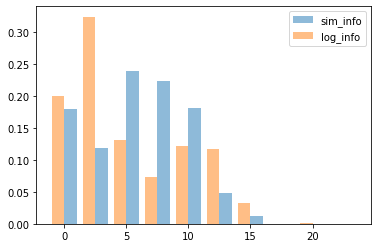

In [17]:
import tensorflow_probability as tfp
import matplotlib.pyplot as plt  
# 获取直方图横坐标分区
bar_width=1
edges = tf.cast(tf.linspace(0, 25, 10+1), tf.float32)
    
# 绘制条形图  
sim_counts = tfp.stats.histogram(preds_filter, edges)
sim_counts /= tf.reduce_sum(sim_counts)
plt.bar(edges[:-1]+0.5*bar_width, sim_counts, align='center', width=bar_width, alpha=0.5, label="sim_info")

log_counts = tfp.stats.histogram(log_filter, edges)
log_counts /= tf.reduce_sum(log_counts)
plt.bar(edges[:-1]-0.5*bar_width, log_counts, align='center', width=bar_width, alpha=0.5, label="log_info")

plt.legend()
plt.show();
    

In [290]:
# 根据直方图计算两个分布的JS散度

# 方式一：手推公式

import tensorflow as tf  
  
# 假设 sim_counts 和 log_counts 已经是归一化的  
# sim_counts 和 log_counts 是两个Tensor，表示两个离散分布的概率  
  
# 计算平均分布  
correct_sim_counts = sim_counts + 1e-6
correct_log_counts = log_counts + 1e-6
M = (correct_sim_counts + correct_log_counts) / 2  
  
# 计算KL散度  
# 注意：这里使用0来避免log(0)，因为log(0)是未定义的，且当p=0时，p*log(p/q)应视为0  
epsilon = 1e-9  # 为了避免除以0或log(0)  
kl_sim_to_M = tf.reduce_sum(correct_sim_counts * tf.math.log(correct_sim_counts / (M + epsilon)))  
kl_log_to_M = tf.reduce_sum(correct_log_counts * tf.math.log(correct_log_counts / (M + epsilon)))  
  
# 计算JS散度  
js_divergence = 0.5 * (kl_sim_to_M + kl_log_to_M)  
  
print("JS散度1:", js_divergence.numpy())

# 方式二：使用scipy中的函数

from scipy.spatial.distance import jensenshannon
correct_sim_counts = sim_counts + 1e-6
correct_log_counts = log_counts + 1e-6
print("JS散度2:", jensenshannon(correct_sim_counts, correct_log_counts) ** 2)

JS散度1: 0.067313954
JS散度2: 0.06731323897838594


#### 根据核密度估计计算JS散度

JS距离： 0.17977129974311754


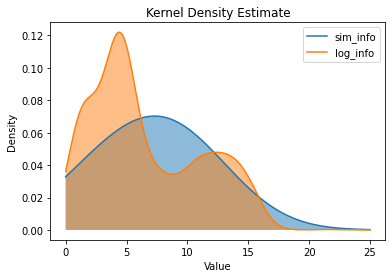

In [320]:
from sklearn.neighbors import KernelDensity
import scipy

def KDE_density(data):
    sigma_std = np.std(data)
    n_length = data.shape[0]
    h_bandwidth = 1.06 * sigma_std * n_length ** (-1/5)
    kde = KernelDensity(kernel="gaussian", bandwidth=h_bandwidth, algorithm="auto").fit(data)
    x_ax = np.linspace(0, 25, 5000).reshape(-1, 1)
    log_density = kde.score_samples(x_ax).reshape(-1, 1)
    density_results = np.exp(log_density).reshape(-1, 1)
    return x_ax, density_results

new_preds_filter = preds_filter.numpy().reshape(-1, 1)
new_log_filter = log_filter.numpy().reshape(-1, 1)

x_a_preds, ds_preds = KDE_density(new_preds_filter)
plt.plot(x_a_preds.ravel(), ds_preds.ravel(), label="sim_info")  
plt.fill_between(x_a_preds.ravel(), ds_preds.ravel(), alpha=0.5)  

x_a_log, ds_log = KDE_density(new_log_filter)
plt.plot(x_a_log.ravel(), ds_log.ravel(), label="log_info")  
plt.fill_between(x_a_log.ravel(), ds_log.ravel(), alpha=0.5)  

m = (ds_preds + ds_log) / 2.0

KL_preds_m = scipy.stats.entropy(ds_preds, m)
KL_log_m = scipy.stats.entropy(ds_log, m)

js_distance = np.sqrt((KL_log_m + KL_preds_m) / 2.0)
print("JS距离:", js_distance[0])

plt.title('Kernel Density Estimate')  
plt.xlabel('Value')  
plt.ylabel('Density') 

plt.legend()
plt.show();

#### 获取轨迹的交互特征

In [330]:
rollout.preds.shape

torch.Size([4, 64, 32, 90, 4])

In [332]:
tf.ones_like(scenario_info[roll_idx][..., 0], dtype=tf.int32)

<tf.Tensor: shape=(64, 90), dtype=int32, numpy=
array([[1, 1, 1, ..., 1, 1, 1],
       [1, 1, 1, ..., 1, 1, 1],
       [1, 1, 1, ..., 1, 1, 1],
       ...,
       [1, 1, 1, ..., 1, 1, 1],
       [1, 1, 1, ..., 1, 1, 1],
       [1, 1, 1, ..., 1, 1, 1]], dtype=int32)>

In [376]:
rollout.preds[idx].shape[1]

32

In [373]:
rollout.preds[idx][:, 1, :, 0].shape

torch.Size([64, 90])

In [355]:
tf.repeat(batch['agent/size'][1][:, 0: 1], 90, axis=-1)

<tf.Tensor: shape=(64, 90), dtype=float32, numpy=
array([[5.286   , 5.286   , 5.286   , ..., 5.286   , 5.286   , 5.286   ],
       [4.778398, 4.778398, 4.778398, ..., 4.778398, 4.778398, 4.778398],
       [4.784562, 4.784562, 4.784562, ..., 4.784562, 4.784562, 4.784562],
       ...,
       [0.      , 0.      , 0.      , ..., 0.      , 0.      , 0.      ],
       [0.      , 0.      , 0.      , ..., 0.      , 0.      , 0.      ],
       [0.      , 0.      , 0.      , ..., 0.      , 0.      , 0.      ]],
      dtype=float32)>

In [383]:
idx = 1

for roll_idx in range(rollout.preds[idx].shape[1]):
    center_x = rollout.preds[idx][:, roll_idx, :, 0]
    center_y = rollout.preds[idx][:, roll_idx, :, 1]
    length = tf.repeat(batch['agent/size'][idx][:, 0: 1], 90, axis=-1)
    width = tf.repeat(batch['agent/size'][idx][:, 1: 2], 90, axis=-1)
    heading = rollout.preds[idx][:, roll_idx, :, 2]
    valid = rollout.valid[idx][:, roll_idx, :]
    # valid = tf.ones_like(scenario_info[roll_idx][..., 0], dtype=tf.int32)
    evaluated_object_mask = tf.cast(tf.ones_like((rollout.preds[idx].shape[0]), dtype=tf.int32), tf.bool)  
    seconds_per_step = 0.1

    compute_time_to_collision_with_object_in_front(center_x, center_y, length, width, 
                                                   heading, valid, evaluated_object_mask, seconds_per_step)
    break

InvalidArgumentError: {{function_node __wrapped__Where_device_/job:localhost/replica:0/task:0/device:CPU:0}} WhereOp : Unhandled input dimensions: 0 [Op:Where]

In [382]:
def compute_time_to_collision_with_object_in_front(
    center_x: tf.Tensor,
    center_y: tf.Tensor,
    length: tf.Tensor,
    width: tf.Tensor,
    heading: tf.Tensor,
    valid: tf.Tensor,
    evaluated_object_mask: tf.Tensor,
    seconds_per_step: float,
) -> tf.Tensor:
  """Computes the time-to-collision of the evaluated objects.

  The time-to-collision measures, in seconds, the time until an object collides
  with the object it is following, assuming constant speeds.

  If an object is not following any valid object, or if the time-to-collision is
  invalid or too large, `MAXIMUM_TIME_TO_COLLISION` is returned for that box.

  Args:
    center_x: A float Tensor of shape (num_objects, num_steps) containing the
      x-component of the object positions.
    center_y: A float Tensor of shape (num_objects, num_steps) containing the
      y-component of the object positions.
    length: A float Tensor of shape (num_objects, num_steps) containing the
      object lengths.
    width: A float Tensor of shape (num_objects, num_steps) containing the
      object widths.
    heading: A float Tensor of shape (num_objects, num_steps) containing the
      object headings.
    valid: A boolean Tensor of shape (num_objects, num_steps) containing the
      validity of the objects over time.
    evaluated_object_mask: A boolean tensor of shape (num_objects), indicating
      whether each object should be considered part of the "evaluation set".
    seconds_per_step: The duration (in seconds) of one step. This is used to
      scale speed and acceleration properly. This is always a positive value,
      usually `submission_specs.STEP_DURATION_SECONDS`.

  Returns:
    A tensor of shape (num_evaluated_objects, num_steps), containing the
    time-to-collision, for each timestep and for all the objects to be
    evaluated, as specified by `evaluated_object_mask`.
  """
  # `speed` shape: (num_objects, num_steps)
  speed = compute_kinematic_features(
      x=center_x,
      y=center_y,
      heading=heading,
      seconds_per_step=seconds_per_step,
  )[0]
  boxes = tf.stack([center_x, center_y, length, width, heading, speed], axis=-1)
  # `boxes` shape: (num_steps, num_objects, 6).
  boxes = tf.transpose(boxes, perm=[1, 0, 2])
  valid = tf.transpose(valid, perm=[1, 0])

  # Gather the boxes based on `evaluated_object_mask`.
  # `eval_boxes` shape: (num_steps, num_evaluated_objects, 6).
  eval_boxes = tf.gather(boxes, tf.where(evaluated_object_mask)[:, 0], axis=1)

  ego_xy, ego_sizes, ego_yaw, ego_speed = tf.split(
      eval_boxes, num_or_size_splits=[2, 2, 1, 1], axis=-1
  )
  other_xy, other_sizes, other_yaw, _ = tf.split(
      boxes, num_or_size_splits=[2, 2, 1, 1], axis=-1
  )

  # Absolute yaw difference between each ego box and every other box.
  # `yaw_diff` shape: (num_steps, num_evaluated_objects, num_objects, 1)
  yaw_diff = tf.math.abs(other_yaw[:, tf.newaxis] - ego_yaw[:, :, tf.newaxis])

  yaw_diff_cos = tf.math.cos(yaw_diff)
  yaw_diff_sin = tf.math.sin(yaw_diff)

  # Longitudinal and lateral offsets from the other box center to its corner(s)
  # closest to the ego box.
  # Note: The relevant corner can be different for the 2 directions. Taking the
  # absolute value of cos(yaw_diff), sin(yaw_diff) is equivalent to taking the
  # maximum over all 4 corners.
  # `other_long_offset` shape: (num_steps, num_evaluated_objects, num_objects)
  other_long_offset = geometry_utils.dot_product_2d(
      other_sizes[:, tf.newaxis] / 2.0,
      tf.math.abs(tf.concat([yaw_diff_cos, yaw_diff_sin], axis=-1)),
  )
  # `other_lat_offset` shape: (num_steps, num_evaluated_objects, num_objects)
  other_lat_offset = geometry_utils.dot_product_2d(
      other_sizes[:, tf.newaxis] / 2.0,
      tf.math.abs(tf.concat([yaw_diff_sin, yaw_diff_cos], axis=-1)),
  )

  # Coordinates of other box center relative to ego box.
  # `other_relative_xy` shape:
  #   (num_steps, num_evaluated_objects, num_objects, 2)
  other_relative_xy = geometry_utils.rotate_2d_points(
      (other_xy[:, tf.newaxis] - ego_xy[:, :, tf.newaxis]),
      -ego_yaw,
  )

  # Longitudinal distance from ego's front side to the most behind other box
  # corner, defined as positive ahead of the ego.
  # `long_distance` shape: (num_steps, num_evaluated_objects, num_objects)
  long_distance = (
      other_relative_xy[..., 0]
      - ego_sizes[:, :, tf.newaxis, 0] / 2.0
      - other_long_offset
  )

  # Lateral overlap of the other box corner onto the ego straight trail.
  # `lat_overlap` shape: (num_steps, num_evaluated_objects, num_objects)
  lat_overlap = (
      tf.math.abs(other_relative_xy[..., 1])
      - ego_sizes[:, :, tf.newaxis, 1] / 2.0
      - other_lat_offset
  )

  # Check that yaw difference, longitudinal distance and lateral overlap
  # satisfy "following" conditions.
  following_mask = _get_object_following_mask(
      long_distance,
      lat_overlap,
      yaw_diff[..., 0],
  )

  # Mask out boxes that are invalid or don't satisfy "following" conditions.
  valid_mask = tf.logical_and(valid[:, tf.newaxis], following_mask)
  # `masked_long_distance` shape: (num_steps, num_eval_objects, num_objects)
  masked_long_distance = (
      long_distance
      + (1.0 - tf.cast(valid_mask, tf.float32)) * EXTREMELY_LARGE_DISTANCE
  )

  # `box_ahead_index` shape: (num_steps, num_evaluated_objects)
  box_ahead_index = tf.math.argmin(masked_long_distance, axis=-1)
  # `distance_to_box_ahead` shape: (num_steps, num_evaluated_objects)
  distance_to_box_ahead = tf.gather(
      masked_long_distance, box_ahead_index, batch_dims=2
  )
  # `box_ahead_speed` shape: (num_steps, num_evaluated_objects)
  box_ahead_speed = tf.gather(
      tf.broadcast_to(
          tf.transpose(
              speed[
                  :,
                  tf.newaxis,
                  :,
              ]
          ),
          masked_long_distance.shape,
      ),
      box_ahead_index,
      batch_dims=2,
  )

  rel_speed = ego_speed[..., 0] - box_ahead_speed
  # `time_to_collision` shape: (num_steps, num_evaluated_objects)
  time_to_collision = tf.where(
      rel_speed > 0.0,
      tf.minimum(distance_to_box_ahead / rel_speed, MAXIMUM_TIME_TO_COLLISION),
      MAXIMUM_TIME_TO_COLLISION,
  )
  return tf.transpose(time_to_collision, [1, 0])


def _get_object_following_mask(
    longitudinal_distance: tf.Tensor,
    lateral_overlap: tf.Tensor,
    yaw_diff: tf.Tensor,
) -> tf.Tensor:
  """Checks whether objects satisfy criteria for following another object.

  An object on which the criteria are applied is called "ego object" in this
  function to disambiguate it from the other objects acting as obstacles.

  An "ego" object is considered to be following another object if they satisfy
  conditions on the longitudinal distance, lateral overlap, and yaw alignment
  between them.

  Args:
    longitudinal_distance: A float Tensor with shape (batch_dim, num_egos,
      num_others) containing longitudinal distances from the back side of each
      ego box to every other boxes.
    lateral_overlap: A float Tensor with shape (batch_dim, num_egos, num_others)
      containing lateral overlaps of other boxes over the trails of ego boxes.
    yaw_diff: A float Tensor with shape (batch_dim, num_egos, num_others)
      containing absolute yaw differences between egos and other boxes.

  Returns:
    A boolean Tensor with shape (batch_dim, num_egos, num_others) indicating for
    each ego box if it is following the other boxes.
  """
  # Check object is ahead of the ego box's front.
  valid_mask = longitudinal_distance > 0.0

  # Check alignment.
  valid_mask = tf.logical_and(valid_mask, yaw_diff <= MAX_HEADING_DIFF)

  # Check object is directly ahead of the ego box.
  valid_mask = tf.logical_and(valid_mask, lateral_overlap < 0.0)

  # Check strict alignment if the overlap is small.
  # `lateral_overlap` is a signed penetration distance: it is negative when the
  # boxes have an actual lateral overlap.
  return tf.logical_and(
      valid_mask,
      tf.logical_or(
          lateral_overlap < -SMALL_OVERLAP_THRESHOLD,
          yaw_diff <= MAX_HEADING_DIFF_FOR_SMALL_OVERLAP,
      ),
  )

In [6]:
wosac_data = model.wosac_post_processing(batch, rollout)
scenario_rollouts = model.wosac_post_processing.get_scenario_rollouts(wosac_data)

idx = torch.arange(batch['episode_idx'].shape[0])[batch['episode_idx'] == best_scene_idx][0]
best_scenario = batch['scenario_bytes'][idx]
best_scenario_rollout = scenario_rollouts[idx]

scenario_metrics = model.wosac_metrics._compute_scenario_metrics(
    model.wosac_metrics.load_metrics_config(), 
    best_scenario,
    best_scenario_rollout
)
print(scenario_metrics)

scenario_id: "37d41f0cd357379d"
metametric: 0.41001105308532715
average_displacement_error: 6.100980281829834
linear_speed_likelihood: 0.23264062404632568
linear_acceleration_likelihood: 0.16440141201019287
angular_speed_likelihood: 0.19168098270893097
angular_acceleration_likelihood: 0.394832968711853
distance_to_nearest_object_likelihood: 0.4143337607383728
collision_indication_likelihood: 0.22168250381946564
time_to_collision_likelihood: 0.7315817475318909
distance_to_road_edge_likelihood: 0.6331292390823364
offroad_indication_likelihood: 0.5100326538085938
min_average_displacement_error: 4.447112083435059
simulated_collision_rate: 0.3888888955116272
simulated_offroad_rate: 0.3298611044883728



### 提取wosac指标计算所需特征

In [384]:
import collections
import dataclasses

import tensorflow as tf
import numpy as np

from waymo_open_dataset.protos import scenario_pb2
from waymo_open_dataset.protos import sim_agents_submission_pb2
from waymo_open_dataset.utils import trajectory_utils
from waymo_open_dataset.utils.sim_agents import converters
from waymo_open_dataset.utils.sim_agents import submission_specs
from waymo_open_dataset.wdl_limited.sim_agents_metrics import interaction_features
from waymo_open_dataset.wdl_limited.sim_agents_metrics import map_metric_features
from waymo_open_dataset.wdl_limited.sim_agents_metrics import trajectory_features

@dataclasses.dataclass(frozen=True)
class MetricFeatures:
  """Collection of features used to compute sim-agent metrics.

  These features may be a function of simulated data (e.g. dynamics and
  collisions), logged data (e.g. displacement) and map features (e.g. offroad).

  This class can be used to represent both features coming from the original
  Scenario and features from simulation. The samples dimension is set
  accordingly depending on the source (n_samples=1 for log and n_samples=32 for
  simulation).

  Some of the features are computed in 3D (x/y/z) to have better consistency
  with the original data and making these metrics more suitable for future
  updates.

  Attributes:
    object_id: A tensor of shape (n_objects,), containing the integer IDs of all
      the evaluated objects. The object_id tensor is not batched because all the
      objects need to be consistent over samples for proper evaluation.
    valid: Boolean tensor of shape (n_samples, n_objects, n_steps), identifying
      which objects are valid over time. This is used to filter the features
      when computing metrics.
    average_displacement_error: Per-object average (over time) displacement
      error compared to the logged trajectory. Shape: (n_samples, n_objects).
    linear_speed: Linear speed in 3D computed as the 1-step difference between
      trajectory points. Shape: (n_samples, n_objects, n_steps).
    linear_acceleration: Linear acceleration in 3D computed as the 1-step
      difference between speeds of objects.
      Shape: (n_samples, n_objects, n_steps).
    angular_speed: Angular speed computed as the 1-step difference in heading.
      Shape: (n_samples, n_objects, n_steps).
    angular_acceleration: Angular acceleration computed as the 1-step difference
      in angular_speed. Shape: (n_samples, n_objects, n_steps).
    distance_to_nearest_object: Signed distance (in meters) to the nearest
      object in the scene. Shape: (n_samples, n_objects, n_steps).
    collision_per_step: Boolean tensor indicating whether the object collided,
      with any other object. Shape: (n_samples, n_objects, n_steps).
    time_to_collision: Time (in seconds) before the object collides with the
      object it is following (if it exists), assuming constant speeds.
      Shape: (n_samples, n_objects, n_steps).
    distance_to_road_edge: Signed distance (in meters) to the nearest road edge
      in the scene. Shape: (n_samples, n_objects, n_steps).
    offroad_per_step: Boolean tensor indicating whether the object went
      off-road. Shape: (n_samples, n_objects, n_steps).
  """
  object_id: tf.Tensor
  valid: tf.Tensor
  average_displacement_error: tf.Tensor
  linear_speed: tf.Tensor
  linear_acceleration: tf.Tensor
  angular_speed: tf.Tensor
  angular_acceleration: tf.Tensor
  distance_to_nearest_object: tf.Tensor
  collision_per_step: tf.Tensor
  time_to_collision: tf.Tensor
  distance_to_road_edge: tf.Tensor
  offroad_per_step: tf.Tensor

def compute_displacement_error(
    x: tf.Tensor, y: tf.Tensor, z: tf.Tensor,
    ref_x: tf.Tensor, ref_y: tf.Tensor, ref_z: tf.Tensor) -> tf.Tensor:
  """Computes displacement error (in x,y,z) w.r.t. a reference trajectory.

  Note: This operation doesn't put any constraint on the shape of the tensors,
  except that they are all consistent with each other, so this can be used
  with any arbitrary tensor shape.

  Args:
    x: The x-component of the predicted trajectories.
    y: The y-component of the predicted trajectories.
    z: The z-component of the predicted trajectories.
    ref_x: The x-component of the reference trajectories.
    ref_y: The y-component of the reference trajectories.
    ref_z: The z-component of the reference trajectories.

  Returns:
    A float tensor with the same shape as all the arguments, containing
    the 3D distance between the predicted trajectories and the reference
    trajectories.
  """
  # return tf.linalg.norm(
  #     tf.stack([x, y, z], axis=-1) - tf.stack([ref_x, ref_y, ref_z], axis=-1),
  #     ord='euclidean', axis=-1)
  return tf.linalg.norm(
        tf.stack([x, y], axis=-1) - tf.stack([ref_x, ref_y], axis=-1),
        ord='euclidean', axis=-1)

def central_diff(t: tf.Tensor, pad_value: float) -> tf.Tensor:
  """Computes the central difference along the last axis.

  This function is used to compute 1st order derivatives (speeds) when called
  once. Calling this function twice is used to compute 2nd order derivatives
  (accelerations) instead.
  This function returns the central difference as
  df(x)/dx = [f(x+h)-f(x-h)] / 2h.

  Args:
    t: A float Tensor of shape [..., steps].
    pad_value: To maintain the original tensor shape, this value is prepended
      once and appended once to the difference.

  Returns:
    A Tensor of shape [..., steps] containing the central differences,
    appropriately prepended and appended with `pad_value` to maintain the
    original shape.
  """
  # Prepare the tensor containing the value(s) to pad the result with.
  pad_shape = (*t.shape[:-1], 1)
  pad_tensor = tf.fill(pad_shape, pad_value)
  diff_t = (t[..., 2:] - t[..., :-2]) / 2
  return tf.concat([pad_tensor, diff_t, pad_tensor], axis=-1)

def _wrap_angle(angle: tf.Tensor) -> tf.Tensor:
  """Wraps angles in the range [-pi, pi]."""
  return (angle + np.pi) % (2 * np.pi) - np.pi

def compute_kinematic_features(
    x: tf.Tensor,
    y: tf.Tensor,
    z: tf.Tensor,
    heading: tf.Tensor,
    seconds_per_step: float
):
  """Computes kinematic features (speeds and accelerations).

  Note: Everything is assumed to be valid, filtering must be done afterwards.
  To maintain the original tensor length, speeds are prepended and appended
  with 1 np.nan, while accelerations with 2 np.nan (since central difference
  invalidated the two extremes).

  Args:
    x: A float tensor of shape (..., num_steps) containing x coordinates.
    y: A float tensor of shape (..., num_steps) containing y coordinates.
    z: A float tensor of shape (..., num_steps) containing z coordinates.
    heading: A float tensor of shape (..., num_steps,) containing heading.
    seconds_per_step: The duration (in seconds) of one step. This is used to
      scale speed and acceleration properly. This is always a positive value,
      usually defaulting to `submission_specs.STEP_DURATION_SECONDS`.

  Returns:
    A tuple containing the following 4 tensors:
      linear_speed: Magnitude of speed in (x, y, z). Shape (..., num_steps).
      linear_acceleration: Linear signed acceleration (changes in linear speed).
        Shape (..., num_steps).
      angular_speed: Angular speed (changes in heading). Shape (..., num_steps).
      angular_acceleration: Angular acceleration (changes in `angular_speed`).
        Shape (..., num_steps).
  """
  # Linear speed and acceleration.
  # dpos = central_diff(tf.stack([x, y, z], axis=0), pad_value=np.nan)
  dpos = central_diff(tf.stack([x, y], axis=0), pad_value=np.nan)
  linear_speed = tf.linalg.norm(
      dpos, ord='euclidean', axis=0) / seconds_per_step
  linear_accel = central_diff(linear_speed, pad_value=np.nan) / seconds_per_step
  # Angular speed and acceleration. Since heading is normalized between
  # [-pi, pi] in Scenarios, we need to correctly wrap deltas between headings.
  # Given 2 headings, there are 2 possible deltas (one acute angle and one
  # obtuse), and by wrapping the delta in [-pi, pi] we are effectively selecting
  # the acute solution (the smaller angle). Using central difference, we are
  # estimating the delta from 2-steps, and we need to make sure the 2-steps
  # delta is acute, otherwise we could be actually selecting the wrong solution
  # for the 1-step delta. To do this, we scale the central difference by 2
  # before wrapping and then scale back. This effectively reduces the maximum
  # delta we can measure as pi/2 rad/step, which at 10Hz corresponds to
  # 5pi/sec, or 2.5 rotations on it own axis per second.
  dh_step = _wrap_angle(central_diff(heading, pad_value=np.nan) * 2) / 2
  dh = dh_step / seconds_per_step
  d2h_step = _wrap_angle(central_diff(dh_step, pad_value=np.nan) * 2) / 2
  d2h = d2h_step / (seconds_per_step**2)
  return linear_speed, linear_accel, dh, d2h

def compute_metric_features(
    scenario: scenario_pb2.Scenario,
    joint_scene: sim_agents_submission_pb2.JointScene,
    use_log_validity: bool = False
) -> MetricFeatures:
  """Computes features for a single scene.

  Args:
    scenario: The `Scenario` loaded from WOMD.
    joint_scene: Single sample of the predicted scene starting from scenario's
      initial conditions.
    use_log_validity: If True, copies the validity mask from the original
      scenario instead of assuming all the steps are valid. This is used to
      compute features for the logged scenario.

  Returns:
    A `MetricFeatures` containing all the features.
  """
  # Extract `ObjectTrajectories` object from the joint scene, prepending the
  # history from the original scenario. These composite trajectories are used to
  # compute dynamics features, which require a few steps of context.
  simulated_trajectories = converters.joint_scene_to_trajectories(
      joint_scene, scenario, use_log_validity=use_log_validity)
  # Extract `ObjectTrajectories` from the original scenario, used for
  # log-comparison metrics (i.e. displacement error). These also need to be
  # aligned to the simulated trajectories.
  logged_trajectories = trajectory_utils.ObjectTrajectories.from_scenario(
      scenario)
  logged_trajectories = logged_trajectories.gather_objects_by_id(
      simulated_trajectories.object_id)
  # From the simulated trajectories, just select the subset of objects that
  # needs evaluation.
  evaluated_sim_agent_ids = tf.convert_to_tensor(
      # TODO: 修改评价的车辆id
      # submission_specs.get_evaluation_sim_agent_ids(scenario)
      submission_specs.get_sim_agent_ids(scenario)
  )
  evaluated_trajectories = simulated_trajectories.gather_objects_by_id(
      evaluated_sim_agent_ids
  )
  # Re-order simulated trajectories, so that evaluated objects appear first,
  # in a particular order.
  non_evaluated_sim_agent_ids = set(
      simulated_trajectories.object_id.numpy()
  ) - set(evaluated_sim_agent_ids.numpy())
  reordered_all_simulated_agent_ids = tf.constant(
      list(evaluated_sim_agent_ids.numpy()) + list(non_evaluated_sim_agent_ids)
  )
  simulated_trajectories = simulated_trajectories.gather_objects_by_id(
      reordered_all_simulated_agent_ids
  )
  # Prune logged trajectories to those that will be evaluated.
  evaluated_logged_trajectories = logged_trajectories.gather_objects_by_id(
      evaluated_sim_agent_ids
  )

  # Validity bit mask.
  if use_log_validity:
    validity_mask = evaluated_logged_trajectories.valid
  else:
    validity_mask = evaluated_trajectories.valid
  # Slice in time to reduce to `submission_specs.N_SIMULATION_STEPS` steps.
  validity_mask = validity_mask[:, submission_specs.CURRENT_TIME_INDEX+1:]

  # Average displacement error (ADE) in 3D. Before averaging over time, the
  # invalid states in the log need to be properly handled.
  displacement_error = compute_displacement_error(
      evaluated_trajectories.x, evaluated_trajectories.y,
      evaluated_trajectories.z, evaluated_logged_trajectories.x,
      evaluated_logged_trajectories.y, evaluated_logged_trajectories.z)
  object_valid_steps = tf.reduce_sum(
      tf.cast(evaluated_logged_trajectories.valid, tf.float32), axis=1)
  ade = tf.reduce_sum(
      tf.where(evaluated_logged_trajectories.valid, displacement_error, 0.0),
      axis=1) / object_valid_steps

  # Kinematics-related features, i.e. speed and acceleration, both linear and
  # angular. These feature are computed as finite differences of the objects
  # position, which makes the first step invalid. We prepend the history steps
  # so that this first simulation step has a valid difference too.
  linear_speed, linear_accel, angular_speed, angular_accel = (
      compute_kinematic_features(
          evaluated_trajectories.x,
          evaluated_trajectories.y,
          evaluated_trajectories.z,
          evaluated_trajectories.heading,
          seconds_per_step=submission_specs.STEP_DURATION_SECONDS))
  # Removes the data corresponding to the history time interval.
  linear_speed, linear_accel, angular_speed, angular_accel = (
      map(lambda t: t[:, submission_specs.CURRENT_TIME_INDEX+1:],
          [linear_speed, linear_accel, angular_speed, angular_accel])
  )

  # Collision and distances to objects.
  evaluated_object_mask = tf.reduce_any(
      # `evaluated_sim_agents` shape: (n_evaluated_objects,).
      # `simulated_trajectories.object_id` shape: (n_objects,).
      evaluated_sim_agent_ids[:, tf.newaxis]
      == simulated_trajectories.object_id,
      axis=0,
  )
  # Interactive features are computed between all simulated objects, but only
  # scored for evaluated objects.
  distances_to_objects = (
      interaction_features.compute_distance_to_nearest_object(
          center_x=simulated_trajectories.x,
          center_y=simulated_trajectories.y,
          center_z=simulated_trajectories.z,
          length=simulated_trajectories.length,
          width=simulated_trajectories.width,
          height=simulated_trajectories.height,
          heading=simulated_trajectories.heading,
          valid=simulated_trajectories.valid,
          evaluated_object_mask=evaluated_object_mask
          ))
  # Slice in time, as `simulated_trajectories` also include the history steps.
  distances_to_objects = (
      distances_to_objects[:, submission_specs.CURRENT_TIME_INDEX+1:])
  # Shape: (n_evaluated_objects, n_steps).
  is_colliding_per_step = tf.less(
      distances_to_objects, interaction_features.COLLISION_DISTANCE_THRESHOLD)

  times_to_collision = (
      interaction_features.compute_time_to_collision_with_object_in_front(
          center_x=simulated_trajectories.x,
          center_y=simulated_trajectories.y,
          length=simulated_trajectories.length,
          width=simulated_trajectories.width,
          heading=simulated_trajectories.heading,
          valid=simulated_trajectories.valid,
          evaluated_object_mask=evaluated_object_mask,
          seconds_per_step=submission_specs.STEP_DURATION_SECONDS,
      )
  )
  times_to_collision = times_to_collision[
      :, submission_specs.CURRENT_TIME_INDEX + 1 :
  ]

  # Roadgraph features.
  road_edges = []
  for map_feature in scenario.map_features:
    if map_feature.HasField('road_edge'):
      road_edges.append(map_feature.road_edge.polyline)
  distances_to_road_edge = map_metric_features.compute_distance_to_road_edge(
      center_x=simulated_trajectories.x,
      center_y=simulated_trajectories.y,
      center_z=simulated_trajectories.z,
      length=simulated_trajectories.length,
      width=simulated_trajectories.width,
      height=simulated_trajectories.height,
      heading=simulated_trajectories.heading,
      valid=simulated_trajectories.valid,
      evaluated_object_mask=evaluated_object_mask,
      road_edge_polylines=road_edges,
  )
  distances_to_road_edge = distances_to_road_edge[
      :, submission_specs.CURRENT_TIME_INDEX + 1 :
  ]
  is_offroad_per_step = tf.greater(
      distances_to_road_edge, map_metric_features.OFFROAD_DISTANCE_THRESHOLD
  )

  # Pack into `MetricFeatures`, also adding a batch dimension of 1 (except for
  # `object_id`).
  return MetricFeatures(
      object_id=evaluated_trajectories.object_id,
      valid=validity_mask[tf.newaxis],
      average_displacement_error=ade[tf.newaxis],
      linear_speed=linear_speed[tf.newaxis],
      linear_acceleration=linear_accel[tf.newaxis],
      angular_speed=angular_speed[tf.newaxis],
      angular_acceleration=angular_accel[tf.newaxis],
      distance_to_nearest_object=distances_to_objects[tf.newaxis],
      collision_per_step=is_colliding_per_step[tf.newaxis],
      time_to_collision=times_to_collision[tf.newaxis],
      distance_to_road_edge=distances_to_road_edge[tf.newaxis],
      offroad_per_step=is_offroad_per_step[tf.newaxis],
  )

def compute_scenario_rollouts_features(
    scenario: scenario_pb2.Scenario,
    scenario_rollouts: sim_agents_submission_pb2.ScenarioRollouts
) -> tuple[MetricFeatures, MetricFeatures]:
  """Computes the metrics features for both logged and simulated scenarios.

  Args:
    scenario: The `Scenario` loaded from WOMD.
    scenario_rollouts: The collection of joint scenes from simulation.

  Returns:
    Two `MetricFeatures`, the first one from logged data with n_samples=1 and
    the second from simulation with n_samples=`submission_specs.N_ROLLOUTS`.
  """
  log_joint_scene = converters.scenario_to_joint_scene(scenario)
  log_features = compute_metric_features(
      scenario, log_joint_scene, use_log_validity=True)

  # Aggregate the different parallel simulations.
  features_fields = [field.name for field in dataclasses.fields(MetricFeatures)]
  features_fields.remove('object_id')
  sim_features = collections.defaultdict(list)
  for joint_scene in scenario_rollouts.joint_scenes:
    rollout_features = compute_metric_features(scenario, joint_scene)
    if tf.reduce_any(log_features.object_id != rollout_features.object_id):
      raise ValueError('Misaligned object IDs for evaluation.')
    for field in features_fields:
      sim_features[field].append(getattr(rollout_features, field))

  # Concatenate and generate `MetricFeatures`.
  for field in features_fields:
    sim_features[field] = tf.concat(sim_features[field], axis=0)

  sim_features = MetricFeatures(
      **sim_features, object_id=log_features.object_id)
  return log_features, sim_features

In [385]:
wosac_data = model.wosac_post_processing(batch, rollout)
scenario_rollouts = model.wosac_post_processing.get_scenario_rollouts(wosac_data)

idx = torch.arange(batch['episode_idx'].shape[0])[batch['episode_idx'] == best_scene_idx][0]
best_scenario = batch['scenario_bytes'][idx]
best_scenario_rollout = scenario_rollouts[idx]

log_features, sim_features = (
    compute_scenario_rollouts_features(
        scenario_pb2.Scenario.FromString(bytes.fromhex(best_scenario)), best_scenario_rollout)
)

TODO: 以下为测试内容

In [418]:
a = sim_features.linear_acceleration.numpy()
a[np.isnan(a)] = 0.0

np.min(a)

-133817.2

### 绘制提取的特征信息

In [386]:
import matplotlib.pyplot as plt

def plot_metric_feature(scenario, single_scene_features):
    scenario = scenario_pb2.Scenario.FromString(bytes.fromhex(best_scenario))
    # These features will be computed only for the `tracks_to_predict` objects.
    print(f'Evaluated objects: {submission_specs.get_evaluation_sim_agent_ids(scenario)}')
    # This will also match single_scene_features.object_ids
    print(f'Evaluated objects in features: {single_scene_features.object_id}')

    # Features contain a validity flag, which for simulated rollouts must be always
    # True, because we are requiring the sim agents to be always valid when replaced.
    print(f'Are all agents valid: {tf.reduce_all(single_scene_features.valid)}')

    # ============ FEATURES ============
    # Average displacement feature. This corresponds to ADE in the BP challenges,
    # here is used just as a comparison (it's not actually included in the final score).
    # Shape: (1, n_objects).
    print(f'ADE: {tf.reduce_mean(single_scene_features.average_displacement_error)}')

    # Kinematic features.
    print('\n============ KINEMATIC FEATURES ============')
    fig, axes = plt.subplots(1, 4, figsize=(16, 4))
    for i_object in range(len(single_scene_features.object_id)):
        _object_id = single_scene_features.object_id[i_object].numpy()
        axes[0].plot(single_scene_features.linear_speed[0, i_object, :], label=str(_object_id))
        axes[1].plot(single_scene_features.linear_acceleration[0, i_object, :], label=str(_object_id))
        axes[2].plot(single_scene_features.angular_speed[0, i_object, :], label=str(_object_id))
        axes[3].plot(single_scene_features.angular_acceleration[0, i_object, :], label=str(_object_id))

    TITLES = ['linear_speed', 'linear_acceleration', 'angular_speed', 'angular_acceleration']
    for ax, title in zip(axes, TITLES):
        ax.legend()
        ax.set_title(title)
    plt.show()

    # Interactive features.
    print('\n============ INTERACTIVE FEATURES ============')
    # print(f'Colliding objects: {single_scene_features.collision_indication[0]}')
    fig, axes = plt.subplots(1, 2, figsize=(8, 4))
    for i_object in range(len(single_scene_features.object_id)):
        _object_id = single_scene_features.object_id[i_object].numpy()
        axes[0].plot(single_scene_features.distance_to_nearest_object[0, i_object, :], label=str(_object_id))
        axes[1].plot(single_scene_features.time_to_collision[0, i_object, :], label=str(_object_id))

    TITLES = ['distance to nearest object', 'time to collision']
    for ax, title in zip(axes, TITLES):
        ax.legend()
        ax.set_title(title)
    plt.show();

    # Map-based features.
    print('\n============ MAP-BASED FEATURES ============')
    # print(f'Offroad objects: {single_scene_features.offroad_indication[0]}')
    fig, axes = plt.subplots(1, 1, figsize=(4, 4))
    for i_object in range(len(single_scene_features.object_id)):
        _object_id = single_scene_features.object_id[i_object].numpy()
        axes.plot(single_scene_features.distance_to_road_edge[0, i_object, :], label=str(_object_id))
    axes.legend()
    axes.set_title('distance to road edge')

    plt.show();

Evaluated objects: [226, 244, 247, 248, 249, 258, 263, 269, 1013]
Evaluated objects in features: [ 258  263  266  269  272  213  214  215  216  217  218  219  221  222
  224  226  227  228  229  230  231  232  233  234  235  236  238  239
  240  241  243  244  245  247  248  249  250  252  253  254  255 1013]
Are all agents valid: True
ADE: 1.5238767862319946

============ KINEMATIC FEATURES ============


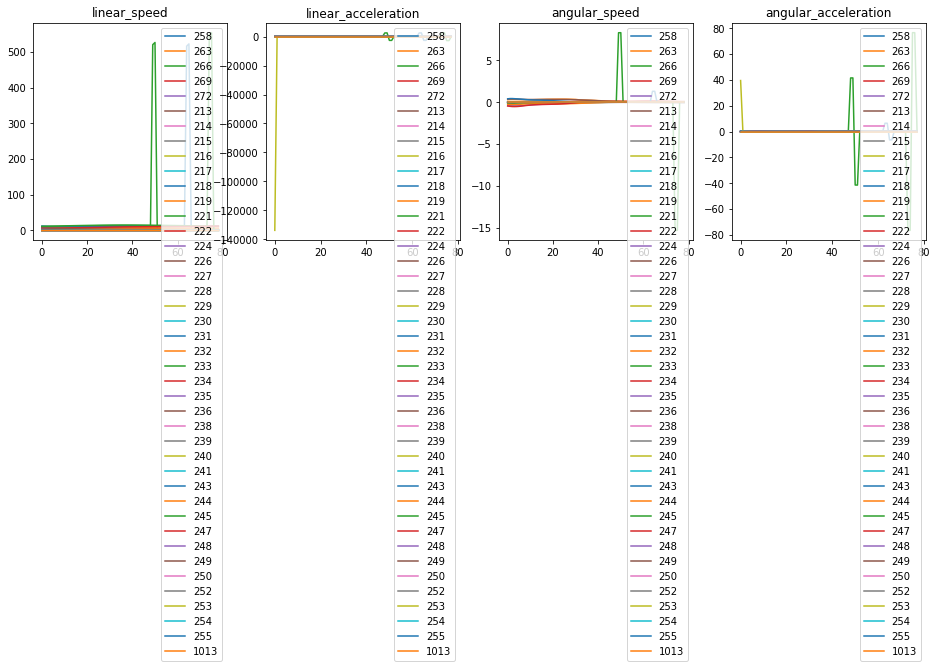


============ INTERACTIVE FEATURES ============


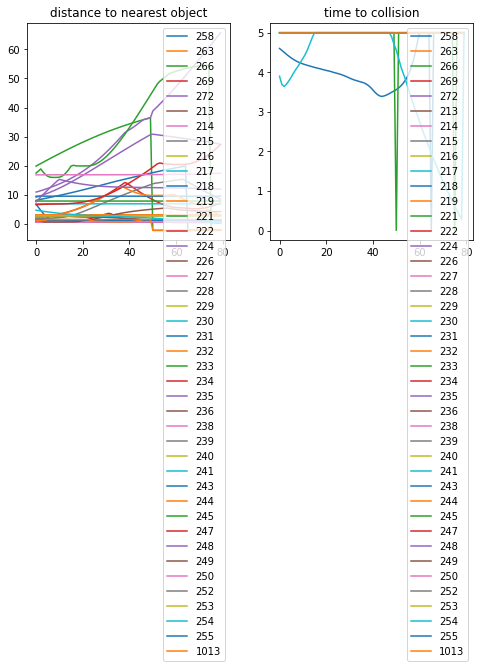


============ MAP-BASED FEATURES ============


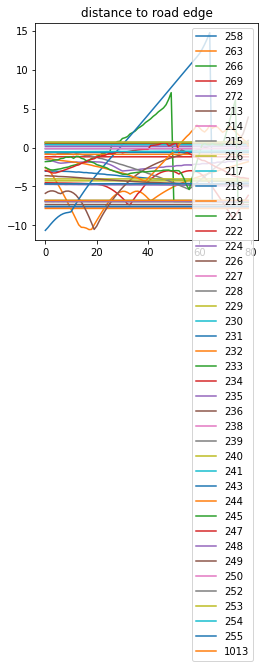

In [387]:
plot_metric_feature(best_scenario, sim_features)

### 绘制场景仿真动画

In [73]:
from waymo_open_dataset.utils.sim_agents import visualizations
# Set matplotlib to jshtml so animations work with colab.
from matplotlib import rc
rc('animation', html='jshtml')

# Select which how the 32 simulations we want visualize.
SAMPLE_INDEX = 0

n_rollouts = len(best_scenario_rollout.joint_scenes)
n_ag_valid = len(best_scenario_rollout.joint_scenes[0].simulated_trajectories)
n_sim_step = len(best_scenario_rollout.joint_scenes[0].simulated_trajectories[0].center_x)

# 创建一个 32*42*80 的空张量
simulated_states = np.zeros((n_rollouts, n_ag_valid, n_sim_step, 4))

# 填充张量
for i in range(n_rollouts):
    for j in range(n_ag_valid):
        simulated_states[i, j, :, 0] = best_scenario_rollout.joint_scenes[i].simulated_trajectories[j].center_x
        simulated_states[i, j, :, 1] = best_scenario_rollout.joint_scenes[i].simulated_trajectories[j].center_y
        simulated_states[i, j, :, 3] = best_scenario_rollout.joint_scenes[i].simulated_trajectories[j].heading

lengths = tf.broadcast_to(4.4, (n_ag_valid, n_sim_step))
widths = tf.broadcast_to(2.2, (n_ag_valid, n_sim_step))

fig, ax = plt.subplots(1, 1, figsize=(10, 10))
ani = visualizations.get_animated_states(
    fig, ax, scenario_pb2.Scenario.FromString(bytes.fromhex(best_scenario)), simulated_states[SAMPLE_INDEX, :, :, 0],
    simulated_states[SAMPLE_INDEX, :, :, 1], simulated_states[SAMPLE_INDEX, :, :, 3], lengths, widths,
    color_idx=tf.zeros((50, 80), dtype=tf.int32))
ani.save('/home/yangyh408/codes/DataDriven_BehaviourModels/deep_learning_model/v1.0/outputs/scene_5.mp4', writer='ffmpeg', fps=10)
ani

/home/yangyh408/anaconda3/envs/traffic_sim_dl/lib/python3.9/_collections_abc.py:1101: MatplotlibDeprecationWarning: The modification of the Axes.patches property was deprecated in Matplotlib 3.5 and will be removed two minor releases later. Use Artist.remove() instead.
  del self[index]
/home/yangyh408/anaconda3/envs/traffic_sim_dl/lib/python3.9/_collections_abc.py:1101: MatplotlibDeprecationWarning: The modification of the Axes.patches property was deprecated in Matplotlib 3.5 and will be removed two minor releases later. Use Artist.remove() instead.
  del self[index]
/home/yangyh408/anaconda3/envs/traffic_sim_dl/lib/python3.9/_collections_abc.py:1101: MatplotlibDeprecationWarning: The modification of the Axes.patches property was deprecated in Matplotlib 3.5 and will be removed two minor releases later. Use Artist.remove() instead.
  del self[index]


### 绘制各指标原始分布与预测分布图

In [390]:
config = model.wosac_metrics.load_metrics_config()
config

linear_speed {
  histogram {
    min_val: 0.0
    max_val: 25.0
    num_bins: 10
    additive_smoothing_pseudocount: 0.10000000149011612
  }
  independent_timesteps: true
  metametric_weight: 0.05000000074505806
}
linear_acceleration {
  histogram {
    min_val: -12.0
    max_val: 12.0
    num_bins: 11
    additive_smoothing_pseudocount: 0.10000000149011612
  }
  independent_timesteps: true
  metametric_weight: 0.05000000074505806
}
angular_speed {
  histogram {
    min_val: -0.628000020980835
    max_val: 0.628000020980835
    num_bins: 11
    additive_smoothing_pseudocount: 0.10000000149011612
  }
  independent_timesteps: true
  metametric_weight: 0.05000000074505806
}
angular_acceleration {
  histogram {
    min_val: -3.140000104904175
    max_val: 3.140000104904175
    num_bins: 11
    additive_smoothing_pseudocount: 0.10000000149011612
  }
  independent_timesteps: true
  metametric_weight: 0.05000000074505806
}
distance_to_nearest_object {
  histogram {
    min_val: -5.0
    max_v

In [391]:
import tensorflow as tf
import matplotlib.pyplot as plt  
import tensorflow_probability as tfp
from waymo_open_dataset.protos import sim_agents_metrics_pb2

def plot_feature_histogram(
    feature_config: sim_agents_metrics_pb2.SimAgentMetricsConfig.FeatureConfig,
    log_values: tf.Tensor,
    sim_values: tf.Tensor,
    bar_width: float,
    title: str,
    xlabel: str,
) -> tf.Tensor:
    """Computes the log-likelihood estimates for a time-series simulated feature.

    Args:
        feature_config: A time-series compatible `FeatureConfig`.
        log_values: A float Tensor with shape (n_objects, n_steps).
        sim_values: A float Tensor with shape (n_rollouts, n_objects, n_steps).

    Returns:
        A tensor of shape (n_objects, n_steps) containing the log probability
        estimates of the log features under the simulated distribution of the same
        feature.
    """
    n_rollouts, n_objects, n_steps = sim_values.shape

    if feature_config.independent_timesteps:
        # If time steps needs to be considered independent, reshape:
        # - `sim_values` as (n_objects, n_rollouts * n_steps)
        # - `log_values` as (n_objects, n_steps)
        sim_values = tf.reshape(tf.transpose(sim_values, [1, 0, 2]),
                                (n_objects, n_rollouts * n_steps))
    else:
        # If values in time are instead to be compared per-step, reshape:
        # - `sim_values` as (n_objects * n_steps, n_rollouts)
        # - `log_values` as (n_objects * n_steps, 1)
        sim_values = tf.reshape(tf.transpose(sim_values, [1, 2, 0]),
                                (n_objects * n_steps, n_rollouts))
        log_values = tf.reshape(log_values, (n_objects * n_steps, 1))

    # 获取直方图横坐标分区
    edges = tf.cast(tf.linspace(
        feature_config.histogram.min_val, feature_config.histogram.max_val, feature_config.histogram.num_bins+1), tf.float32)
    # 限定sim和log特征值范围
    sim_values = tf.clip_by_value(
        sim_values, feature_config.histogram.min_val, feature_config.histogram.max_val)
    log_values = tf.clip_by_value(
        log_values, feature_config.histogram.min_val, feature_config.histogram.max_val)
    
    # 绘制条形图  
    sim_counts = tf.transpose(tfp.stats.histogram(sim_values, edges, axis=1))
    sim_counts = tf.reduce_sum(sim_counts, axis=0, keepdims=False)
    sim_counts /= tf.reduce_sum(sim_counts)
    # sim_counts /= tf.reduce_sum(sim_counts, axis=1, keepdims=True)
    # for sim_count in sim_counts:
    plt.bar(edges[:-1]+0.5*bar_width, sim_counts, align='center', width=bar_width, alpha=0.5, label="sim_info")
    log_counts = tf.transpose(tfp.stats.histogram(log_values, edges, axis=1))
    log_counts = tf.reduce_sum(log_counts, axis=0, keepdims=False)
    log_counts /= tf.reduce_sum(log_counts)
    # log_counts /= tf.reduce_sum(log_counts, axis=1, keepdims=True)
    plt.bar(edges[:-1]-0.5*bar_width, log_counts, align='center', width=bar_width, alpha=0.5, label="log_info")
    
    # 添加标题和轴标签  
    plt.title(title)  
    plt.xlabel(xlabel)  
    plt.ylabel('Probability')
    plt.legend()
    
    plt.show()



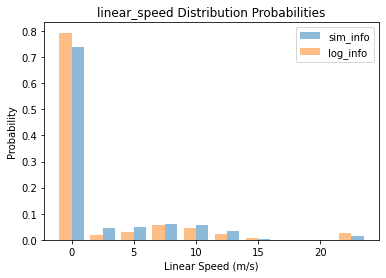

linear_speed_likelihood: 0.23264062404632568


In [392]:
# 绘制 linear_speed
plot_feature_histogram(
    feature_config=config.linear_speed,
    log_values=log_features.linear_speed[0],
    sim_values=sim_features.linear_speed,
    bar_width=1,
    title="linear_speed Distribution Probabilities",
    xlabel="Linear Speed (m/s)",
)
print(f"linear_speed_likelihood: {scenario_metrics.linear_speed_likelihood}")

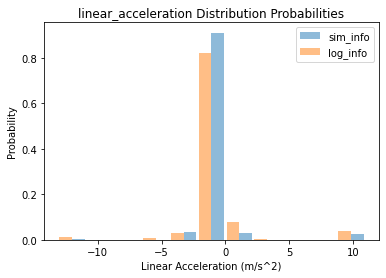

linear_acceleration_likelihood: 0.16440141201019287


In [393]:
# 绘制 linear_acceleration
plot_feature_histogram(
    feature_config=config.linear_acceleration,
    log_values=log_features.linear_acceleration[0],
    sim_values=sim_features.linear_acceleration,
    bar_width=1,
    title="linear_acceleration Distribution Probabilities",
    xlabel="Linear Acceleration (m/s^2)",
)
print(f"linear_acceleration_likelihood: {scenario_metrics.linear_acceleration_likelihood}")

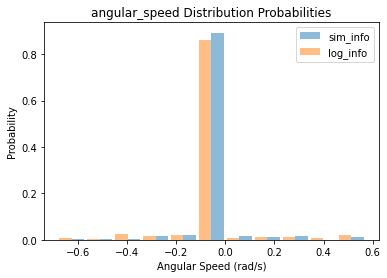

angular_speed_likelihood: 0.19168098270893097


In [394]:
# 绘制 angular_speed
plot_feature_histogram(
    feature_config=config.angular_speed,
    log_values=log_features.angular_speed[0],
    sim_values=sim_features.angular_speed,
    bar_width=0.05,
    title="angular_speed Distribution Probabilities",
    xlabel="Angular Speed (rad/s)",
)
print(f"angular_speed_likelihood: {scenario_metrics.angular_speed_likelihood}")

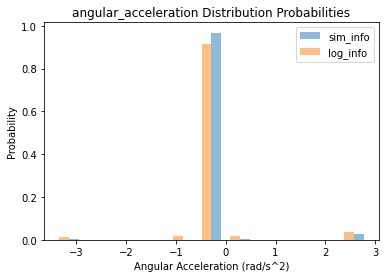

angular_acceleration_likelihood: 0.394832968711853


In [395]:
# 绘制 angular_acceleration
plot_feature_histogram(
    feature_config=config.angular_acceleration,
    log_values=log_features.angular_acceleration[0],
    sim_values=sim_features.angular_acceleration,
    bar_width=0.2,
    title="angular_acceleration Distribution Probabilities",
    xlabel="Angular Acceleration (rad/s^2)",
)
print(f"angular_acceleration_likelihood: {scenario_metrics.angular_acceleration_likelihood}")

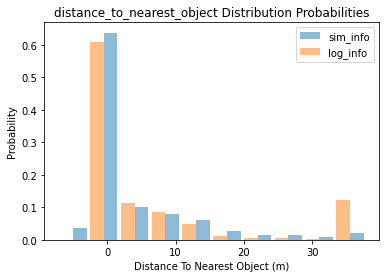

distance_to_nearest_object_likelihood: 0.4143337607383728


In [396]:
# 绘制 distance_to_nearest_object
plot_feature_histogram(
    feature_config=config.distance_to_nearest_object,
    log_values=log_features.distance_to_nearest_object[0],
    sim_values=sim_features.distance_to_nearest_object,
    bar_width=2,
    title="distance_to_nearest_object Distribution Probabilities",
    xlabel="Distance To Nearest Object (m)",
)
print(f"distance_to_nearest_object_likelihood: {scenario_metrics.distance_to_nearest_object_likelihood}")

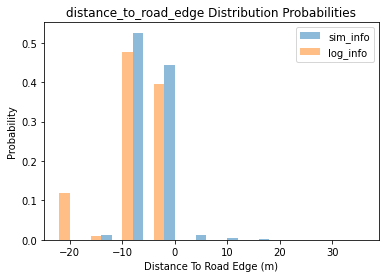

distance_to_road_edge_likelihood: 0.6331292390823364


In [397]:
# 绘制 distance_to_road_edge
plot_feature_histogram(
    feature_config=config.distance_to_road_edge,
    log_values=log_features.distance_to_road_edge[0],
    sim_values=sim_features.distance_to_road_edge,
    bar_width=2,
    title="distance_to_road_edge Distribution Probabilities",
    xlabel="Distance To Road Edge (m)",
)
print(f"distance_to_road_edge_likelihood: {scenario_metrics.distance_to_road_edge_likelihood}")

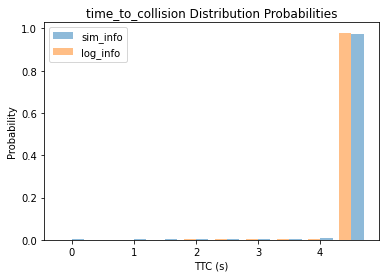

time_to_collision_likelihood: 0.7315817475318909


In [398]:
# 绘制 time_to_collision
plot_feature_histogram(
    feature_config=config.time_to_collision,
    log_values=log_features.time_to_collision[0],
    sim_values=sim_features.time_to_collision,
    bar_width=0.2,
    title="time_to_collision Distribution Probabilities",
    xlabel="TTC (s)",
)
print(f"time_to_collision_likelihood: {scenario_metrics.time_to_collision_likelihood}")

In [399]:
def plot_feature_bernoulli(
    feature_config: sim_agents_metrics_pb2.SimAgentMetricsConfig.FeatureConfig,
    log_values: tf.Tensor,
    sim_values: tf.Tensor,
    bar_width: float,
    title: str,
    xlabel: str,
) -> tf.Tensor:
    n_rollouts, n_objects, n_steps = sim_values.shape

    sim_values = tf.cast(tf.reshape(tf.transpose(sim_values, [1, 2, 0]),
                            (n_objects * n_steps, n_rollouts)), tf.float32)
    log_values = tf.cast(tf.reshape(log_values, (n_objects * n_steps, 1)), tf.float32)

    histogram_config = (
        sim_agents_metrics_pb2.SimAgentMetricsConfig.HistogramEstimate(
            min_val=-0.5, max_val=1.5, num_bins=2,
            additive_smoothing_pseudocount=feature_config.bernoulli.additive_smoothing_pseudocount
        ))
    
    # 获取直方图横坐标分区
    edges = tf.cast(tf.linspace(
        histogram_config.min_val, histogram_config.max_val, histogram_config.num_bins+1), tf.float32)
    # 限定sim和log特征值范围
    sim_values = tf.clip_by_value(
        sim_values, histogram_config.min_val, histogram_config.max_val)
    log_values = tf.clip_by_value(
        log_values, histogram_config.min_val, histogram_config.max_val)
    
    # 绘制条形图  
    sim_counts = tf.transpose(tfp.stats.histogram(sim_values, edges, axis=1))
    sim_counts = tf.reduce_sum(sim_counts, axis=0, keepdims=False)
    sim_counts /= tf.reduce_sum(sim_counts)
    # sim_counts /= tf.reduce_sum(sim_counts, axis=1, keepdims=True)
    # for sim_count in sim_counts:
    plt.bar(edges[:-1]+0.5+0.5*bar_width, sim_counts, align='center', width=bar_width, alpha=0.5, label="sim_info")
    log_counts = tf.transpose(tfp.stats.histogram(log_values, edges, axis=1))
    log_counts = tf.reduce_sum(log_counts, axis=0, keepdims=False)
    log_counts /= tf.reduce_sum(log_counts)
    # log_counts /= tf.reduce_sum(log_counts, axis=1, keepdims=True)
    plt.bar(edges[:-1]+0.5-0.5*bar_width, log_counts, align='center', width=bar_width, alpha=0.5, label="log_info")
    
    # 添加标题和轴标签  
    plt.title(title)  
    plt.xlabel(xlabel)  
    plt.ylabel('Probability')
    plt.legend()
    
    plt.show()

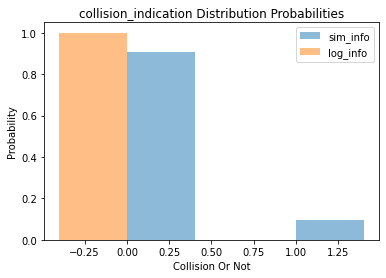

collision_indication_likelihood: 0.22168250381946564


In [400]:
sim_collision_indication = tf.reduce_any(
    tf.where(log_features.valid, sim_features.collision_per_step, False),
    axis=2)
log_collision_indication = tf.reduce_any(
    tf.where(log_features.valid, log_features.collision_per_step, False),
    axis=2)

# 绘制 collision_indication
plot_feature_bernoulli(
    feature_config=config.collision_indication,
    log_values=log_collision_indication[0][..., tf.newaxis],
    sim_values=sim_collision_indication[..., tf.newaxis],
    bar_width=0.4,
    title="collision_indication Distribution Probabilities",
    xlabel="Collision Or Not",
)
print(f"collision_indication_likelihood: {scenario_metrics.collision_indication_likelihood}")

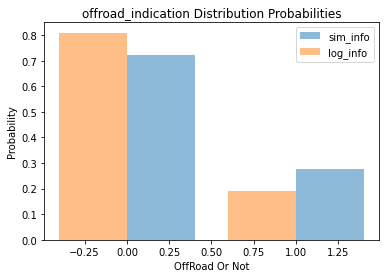

offroad_indication_likelihood: 0.5100326538085938


In [401]:
sim_offroad_indication = tf.reduce_any(
    tf.where(log_features.valid, sim_features.offroad_per_step, False),
    axis=2)
log_offroad_indication = tf.reduce_any(
    tf.where(log_features.valid, log_features.offroad_per_step, False),
    axis=2)

# 绘制 collision_indication
plot_feature_bernoulli(
    feature_config=config.offroad_indication,
    log_values=log_offroad_indication[0][..., tf.newaxis],
    sim_values=sim_offroad_indication[..., tf.newaxis],
    bar_width=0.4,
    title="offroad_indication Distribution Probabilities",
    xlabel="OffRoad Or Not",
)
print(f"offroad_indication_likelihood: {scenario_metrics.offroad_indication_likelihood}")

### WOSAC评价指标接入

In [37]:
# Imports
import os
import numpy as np
import tensorflow as tf
import matplotlib.pyplot as plt

from waymo_open_dataset.wdl_limited.sim_agents_metrics import metric_features
from waymo_open_dataset.wdl_limited.sim_agents_metrics import metrics

from waymo_open_dataset.protos import scenario_pb2
from waymo_open_dataset.protos import sim_agents_submission_pb2

from waymo_open_dataset.utils.sim_agents import submission_specs
from waymo_open_dataset.utils.sim_agents import test_utils as sim_agents_test_utils
from waymo_open_dataset.utils.sim_agents import visualizations
from waymo_open_dataset.utils import trajectory_utils

# Set matplotlib to jshtml so animations work with colab.
from matplotlib import rc
rc('animation', html='jshtml')

### 从源数据加载场景

In [38]:
DATASET_FOLDER = 'data/womd_scenario_v_1_2_0'

# TRAIN_FILES = os.path.join(DATASET_FOLDER, 'training.tfrecord*')
VALIDATION_FILES = os.path.join(DATASET_FOLDER, 'validation', 'validation.tfrecord*')
TEST_FILES = os.path.join(DATASET_FOLDER, 'testing', 'testing.tfrecord*')

# Define the dataset from the TFRecords.
filenames = tf.io.matching_files(VALIDATION_FILES)
dataset = tf.data.TFRecordDataset(filenames)
# Since these are raw Scenario protos, we need to parse them in eager mode.
dataset_iterator = dataset.as_numpy_iterator()

for data in dataset_iterator:
    scenario = scenario_pb2.Scenario.FromString(data)
    if scenario.scenario_id == scenario_id:
        break

2024-07-08 23:22:49.702483: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype string and shape [150]
	 [[{{node Placeholder/_0}}]]


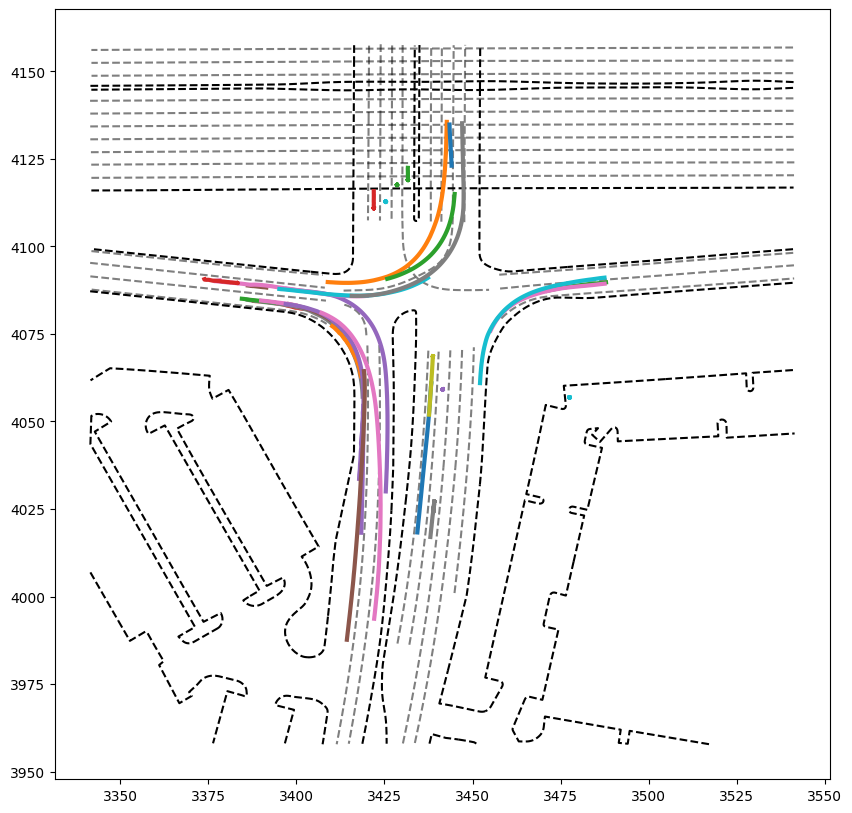

In [39]:
# Visualize scenario.
fig, ax = plt.subplots(1, 1, figsize=(10, 10))

visualizations.add_map(ax, scenario)

def plot_track_trajectory(track: scenario_pb2.Track) -> None:
  valids = np.array([state.valid for state in track.states])
  if np.any(valids):
    x = np.array([state.center_x for state in track.states])
    y = np.array([state.center_y for state in track.states])
    ax.plot(x[valids], y[valids], linewidth=3)

for track in scenario.tracks:
  plot_track_trajectory(track)

plt.show()

Objects to be resimulated: [258, 263, 266, 269, 272, 213, 214, 215, 216, 217, 218, 219, 221, 222, 224, 226, 227, 228, 229, 230, 231, 232, 233, 234, 235, 236, 238, 239, 240, 241, 243, 244, 245, 247, 248, 249, 250, 252, 253, 254, 255, 1013]
Total objects to be resimulated: 42


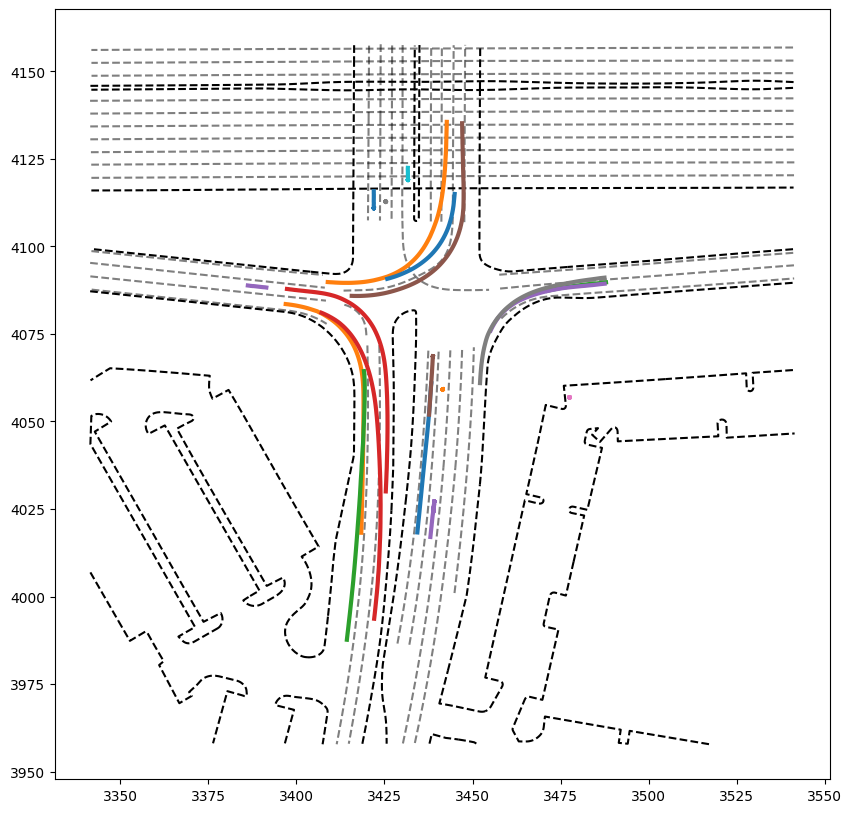

In [47]:
print(f'Objects to be resimulated: {submission_specs.get_sim_agent_ids(scenario)}')
print(f'Total objects to be resimulated: {len(submission_specs.get_sim_agent_ids(scenario))}')

# Plot their tracks.
fig, ax = plt.subplots(1, 1, figsize=(10, 10))
visualizations.add_map(ax, scenario)

for track in scenario.tracks:
  if track.id in submission_specs.get_sim_agent_ids(scenario):
    plot_track_trajectory(track)
    
plt.show();

In [48]:
# 加载该场景的真实轨迹并只保留所需仿真对象及仿真前数据
logged_trajectories = trajectory_utils.ObjectTrajectories.from_scenario(scenario)
print(f'Original shape of tensors inside trajectories: {logged_trajectories.valid.shape} (n_objects, n_steps)')
logged_trajectories = logged_trajectories.gather_objects_by_id(
    tf.convert_to_tensor(submission_specs.get_sim_agent_ids(scenario)))
traj_z = logged_trajectories.z[:, 11:, tf.newaxis]
logged_trajectories = logged_trajectories.slice_time(
    start_index=0, end_index=submission_specs.CURRENT_TIME_INDEX + 1)
print(f'Modified shape of tensors inside trajectories: {logged_trajectories.valid.shape} (n_objects, n_steps)')

Original shape of tensors inside trajectories: (55, 91) (n_objects, n_steps)
Modified shape of tensors inside trajectories: (42, 11) (n_objects, n_steps)


In [51]:
from utils.transform_utils import torch_pos2global, torch_rad2rot, get_transformation_matrix, get_yaw_from_se2
def _arg_gather(tensor: tf.Tensor, reference_tensor: tf.Tensor) -> tf.Tensor:
    tf.assert_rank(tensor, 1)
    tf.assert_rank(reference_tensor, 1)
    # Create the comparison matrix and verify matching items.
    bit_mask = tensor[tf.newaxis, :] == reference_tensor[:, tf.newaxis]
    bit_mask_sum = tf.reduce_sum(tf.cast(bit_mask, tf.int32), axis=1)
    if tf.reduce_any(bit_mask_sum < 1):
        raise ValueError(
            'Some items in `reference_tensor` are missing from `tensor`:'
            f' \n{reference_tensor} \nvs. \n{tensor}.'
        )
    if tf.reduce_any(bit_mask_sum > 1):
        raise ValueError('Some items in `tensor` are repeated.')
    return tf.matmul(
        tf.cast(bit_mask, tf.int32),
        tf.range(0, tensor.shape[0], dtype=tf.int32)[:, tf.newaxis])[:, 0]

# x, y坐标局部坐标向全局坐标转换
preds = torch_pos2global(
    rollout.preds[..., :2].flatten(1, 3), batch['scenario_center'].unsqueeze(1), torch_rad2rot(batch['scenario_yaw'])
).view(rollout.preds[..., :2].shape)
# 航向角局部坐标向全局坐标转换
to_sdc_se3 = get_transformation_matrix(batch['scenario_center'][index], batch['scenario_yaw'][index])
to_sdc_yaw = get_yaw_from_se2(to_sdc_se3)  # for vector
heading_column = rollout.preds[..., 2:3] - to_sdc_yaw
# 将z维度数据设置为0，并拼接上述转换后的信息
zeros_tensor = torch.zeros_like(heading_column)
preds_struct = torch.cat([preds, zeros_tensor, heading_column], axis=-1)[index].squeeze()

print(f'Original shape of tensors inside predictions: {preds_struct.shape} (n_agents, n_steps, 4)')
indices = _arg_gather(batch['agent/object_id'][index], tf.convert_to_tensor(submission_specs.get_sim_agent_ids(scenario)))
simulated_states = tf.gather(preds_struct, indices=indices, axis=0)
simulated_states = tf.concat([simulated_states[..., :2], traj_z, simulated_states[..., -1:]], axis=-1)
simulated_states = tf.tile(simulated_states[tf.newaxis, :, :, :], [submission_specs.N_ROLLOUTS, 1, 1, 1])
print(f'Modified shape of tensors inside predictions: {simulated_states.shape} (n_rollouts, n_objects, n_steps, 4)')

Original shape of tensors inside predictions: torch.Size([64, 80, 4]) (n_agents, n_steps, 4)
Modified shape of tensors inside predictions: (32, 42, 80, 4) (n_rollouts, n_objects, n_steps, 4)


In [38]:
# Select which how the 32 simulations we want visualize.
SAMPLE_INDEX = 0
# We need to extract box sizes (length and width) for all the simulated objects,
# from the 11th step (when one-indexed) of the original scenario.
# Also broadcast in time to be compatible with the other tensors,
# shape (num_objects, num_steps).
n_objects = logged_trajectories.valid.shape[0]
lengths = tf.broadcast_to(
    logged_trajectories.length[:, 10, tf.newaxis],
    (n_objects, submission_specs.N_SIMULATION_STEPS))
widths = tf.broadcast_to(
    logged_trajectories.width[:, 10, tf.newaxis],
    (n_objects, submission_specs.N_SIMULATION_STEPS))

fig, ax = plt.subplots(1, 1, figsize=(10, 10))
visualizations.get_animated_states(
    fig, ax, scenario, simulated_states[0, :, :, 0],
    simulated_states[0, :, :, 1], simulated_states[0, :, :, 3], lengths, widths,
    color_idx=tf.zeros((50, 80), dtype=tf.int32))

In [41]:
# 提取单场景的特征
def joint_scene_from_states(
    states: tf.Tensor, object_ids: tf.Tensor
    ) -> sim_agents_submission_pb2.JointScene:
  # States shape: (num_objects, num_steps, 4).
  # Objects IDs shape: (num_objects,).
  states = states.numpy()
  simulated_trajectories = []
  for i_object in range(len(object_ids)):
    simulated_trajectories.append(sim_agents_submission_pb2.SimulatedTrajectory(
        center_x=states[i_object, :, 0], center_y=states[i_object, :, 1],
        center_z=states[i_object, :, 2], heading=states[i_object, :, 3],
        object_id=object_ids[i_object]
    ))
  return sim_agents_submission_pb2.JointScene(
      simulated_trajectories=simulated_trajectories)

# Package the first simulation into a `JointScene`
joint_scene = joint_scene_from_states(simulated_states[0, :, :, :],
                                      logged_trajectories.object_id)
# Validate the joint scene. Should raise an exception if it's invalid.
submission_specs.validate_joint_scene(joint_scene, scenario)

single_scene_features = metric_features.compute_metric_features(
    scenario, joint_scene)

Evaluated objects: [226, 244, 247, 248, 249, 258, 263, 269, 1013]
Evaluated objects in features: [ 226  244  247  248  249  258  263  269 1013]
Are all agents valid: True
ADE: 2.5406312942504883

============ KINEMATIC FEATURES ============


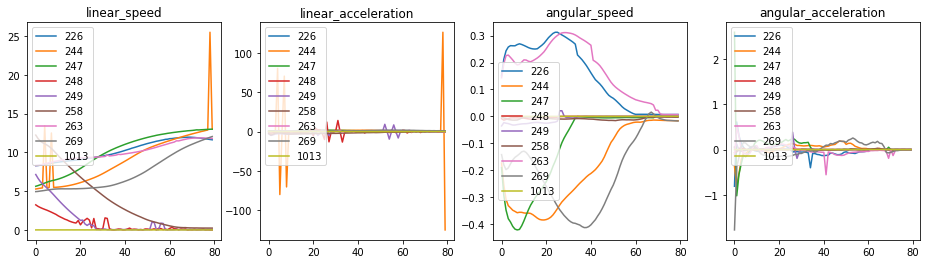


============ INTERACTIVE FEATURES ============
Colliding objects: [ True False False False False False  True False  True]


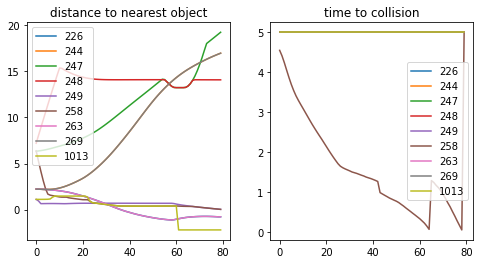


============ MAP-BASED FEATURES ============
Offroad objects: [ True  True  True False False False  True  True False]


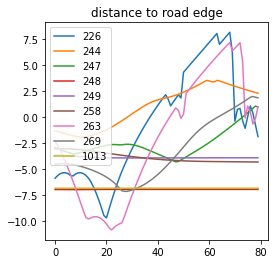

In [42]:
# These features will be computed only for the `tracks_to_predict` objects.
print(f'Evaluated objects: {submission_specs.get_evaluation_sim_agent_ids(scenario)}')
# This will also match single_scene_features.object_ids
print(f'Evaluated objects in features: {single_scene_features.object_id}')

# Features contain a validity flag, which for simulated rollouts must be always
# True, because we are requiring the sim agents to be always valid when replaced.
print(f'Are all agents valid: {tf.reduce_all(single_scene_features.valid)}')

# ============ FEATURES ============
# Average displacement feature. This corresponds to ADE in the BP challenges,
# here is used just as a comparison (it's not actually included in the final score).
# Shape: (1, n_objects).
print(f'ADE: {tf.reduce_mean(single_scene_features.average_displacement_error)}')

# Kinematic features.
print('\n============ KINEMATIC FEATURES ============')
fig, axes = plt.subplots(1, 4, figsize=(16, 4))
for i_object in range(len(single_scene_features.object_id)):
  _object_id = single_scene_features.object_id[i_object].numpy()
  axes[0].plot(single_scene_features.linear_speed[0, i_object, :], label=str(_object_id))
  axes[1].plot(single_scene_features.linear_acceleration[0, i_object, :], label=str(_object_id))
  axes[2].plot(single_scene_features.angular_speed[0, i_object, :], label=str(_object_id))
  axes[3].plot(single_scene_features.angular_acceleration[0, i_object, :], label=str(_object_id))


TITLES = ['linear_speed', 'linear_acceleration', 'angular_speed', 'angular_acceleration']
for ax, title in zip(axes, TITLES):
  ax.legend()
  ax.set_title(title)
plt.show()

# Interactive features.
print('\n============ INTERACTIVE FEATURES ============')
print(f'Colliding objects: {single_scene_features.collision_indication[0]}')
fig, axes = plt.subplots(1, 2, figsize=(8, 4))
for i_object in range(len(single_scene_features.object_id)):
  _object_id = single_scene_features.object_id[i_object].numpy()
  axes[0].plot(single_scene_features.distance_to_nearest_object[0, i_object, :], label=str(_object_id))
  axes[1].plot(single_scene_features.time_to_collision[0, i_object, :], label=str(_object_id))

TITLES = ['distance to nearest object', 'time to collision']
for ax, title in zip(axes, TITLES):
  ax.legend()
  ax.set_title(title)
plt.show();

# Map-based features.
print('\n============ MAP-BASED FEATURES ============')
print(f'Offroad objects: {single_scene_features.offroad_indication[0]}')
fig, axes = plt.subplots(1, 1, figsize=(4, 4))
for i_object in range(len(single_scene_features.object_id)):
  _object_id = single_scene_features.object_id[i_object].numpy()
  axes.plot(single_scene_features.distance_to_road_edge[0, i_object, :], label=str(_object_id))
axes.legend()
axes.set_title('distance to road edge')

plt.show();

In [43]:
# Now we can replicate this strategy to export all the parallel simulations.
def scenario_rollouts_from_states(
    scenario: scenario_pb2.Scenario,
    states: tf.Tensor, object_ids: tf.Tensor
    ) -> sim_agents_submission_pb2.ScenarioRollouts:
  # States shape: (num_rollouts, num_objects, num_steps, 4).
  # Objects IDs shape: (num_objects,).
  joint_scenes = []
  for i_rollout in range(states.shape[0]):
    joint_scenes.append(joint_scene_from_states(states[i_rollout], object_ids))
  return sim_agents_submission_pb2.ScenarioRollouts(
      # Note: remember to include the Scenario ID in the proto message.
      joint_scenes=joint_scenes, scenario_id=scenario.scenario_id)

scenario_rollouts = scenario_rollouts_from_states(
    scenario, simulated_states, logged_trajectories.object_id)
# As before, we can validate the message we just generate.
submission_specs.validate_scenario_rollouts(scenario_rollouts, scenario)

# Load the test configuration.
config = metrics.load_metrics_config(config_path=r"configs/challenge_config.textproto")
scenario_metrics = metrics.compute_scenario_metrics_for_bundle(
    config, scenario, scenario_rollouts)
print(scenario_metrics)

scenario_id: "37d41f0cd357379d"
metametric: 0.20410557091236115
average_displacement_error: 2.5406312942504883
linear_speed_likelihood: 0.310050904750824
linear_acceleration_likelihood: 0.04336630553007126
angular_speed_likelihood: 0.2372259646654129
angular_acceleration_likelihood: 0.05532512441277504
distance_to_nearest_object_likelihood: 0.2376919835805893
collision_indication_likelihood: 0.09973301738500595
time_to_collision_likelihood: 0.6016243696212769
distance_to_road_edge_likelihood: 0.3800900876522064
offroad_indication_likelihood: 0.09973301738500595
min_average_displacement_error: 2.5406312942504883

